# Denoising Diffusion Implicit Models

**Author:** [András Béres](https://www.linkedin.com/in/andras-beres-789190210)<br>
**Date created:** 2022/06/24<br>
**Last modified:** 2022/06/24<br>
**Description:** Generating images of flowers with denoising diffusion implicit models.

In [11]:
!pip install git+https://github.com/lukewood/goa-loader --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/lukewood/goa-loader to /tmp/pip-req-build-86c69wrv
  Running command git clone -q https://github.com/lukewood/goa-loader /tmp/pip-req-build-86c69wrv


In [12]:
import math
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds

from tensorflow import keras
from keras import layers
import goa_loader

## Hyperparameterers

In [13]:
# data
dataset_repetitions = 5
num_epochs = 1  # train for at least 50 epochs for good results
image_size = 64
# KID = Kernel Inception Distance, see related section
kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

# optimization
batch_size = 64
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

## Data pipeline

We will use the
[Oxford Flowers 102](https://www.tensorflow.org/datasets/catalog/oxford_flowers102)
dataset for
generating images of flowers, which is a diverse natural dataset containing around 8,000
images. Unfortunately the official splits are imbalanced, as most of the images are
contained in the test split. We create new splits (80% train, 20% validation) using the
[Tensorflow Datasets slicing API](https://www.tensorflow.org/datasets/splits). We apply
center crops as preprocessing, and repeat the dataset multiple times (reason given in the
next section).

In [23]:

def preprocess_image(image):
    return tf.clip_by_value(image / 255.0, 0.0, 1.0)

# load dataset
train_dataset = goa_loader.load(image_size=(64, 64), percent=10)
train_dataset = train_dataset.cache()
train_dataset = train_dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(10 * batch_size)
train_dataset = train_dataset.repeat(dataset_repetitions)
train_dataset = train_dataset.batch(batch_size, drop_remainder=True)
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

  2%|▏         | 1776/104302 [01:00<34:13, 49.94it/s]

Loading 10430/104302 images


In [24]:

class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()


In [25]:

def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(embedding_min_frequency),
            tf.math.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=keras.activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")


In [26]:

class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = tf.acos(max_signal_rate)
        end_angle = tf.acos(min_signal_rate)

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = tf.cos(diffusion_angles)
        noise_rates = tf.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # the exponential moving average weights are used at evaluation
        if training:
            network = self.network
        else:
            network = self.ema_network

        # predict noise component and calculate the image component using it
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = tf.random.normal(shape=(num_images, image_size, image_size, 3))
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()


## Training

In [27]:
!pip install tensorflow_addons -q
import tensorflow_addons as tfa


  0%|          | 80/104302 [00:27<5:32:25,  5.23it/s]

Epoch 1/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1858 - i_loss: 0.3514

  2%|▏         | 1807/104302 [02:23<2:15:37, 12.60it/s]


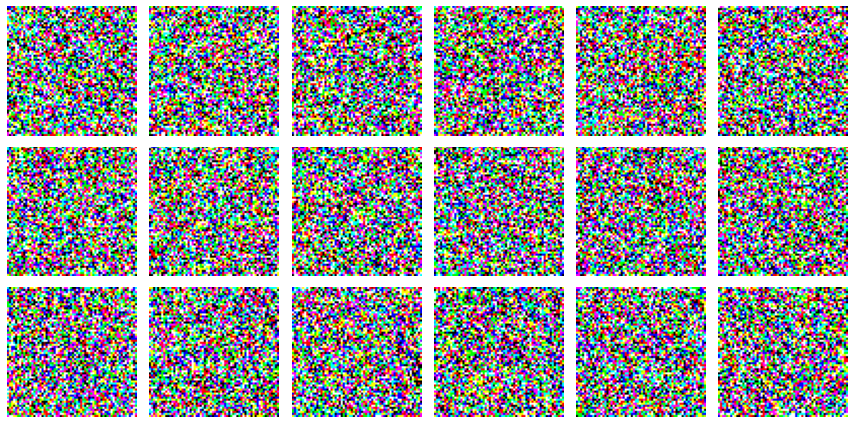

814/814 [==============================] - 70s 65ms/step - n_loss: 0.1858 - i_loss: 0.3514
Epoch 2/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1452 - i_loss: 0.2467

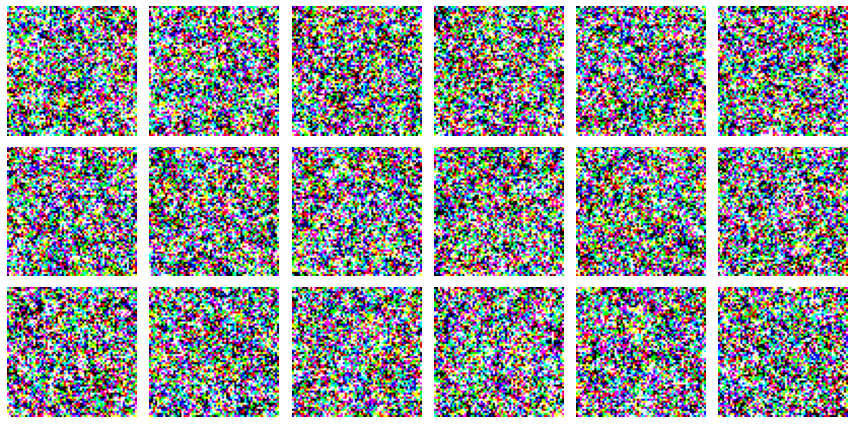

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1452 - i_loss: 0.2467
Epoch 3/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1390 - i_loss: 0.2311

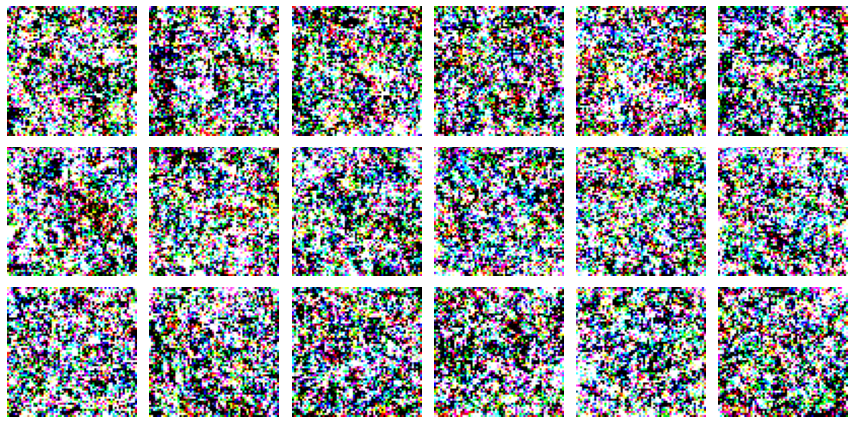

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1390 - i_loss: 0.2311
Epoch 4/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1361 - i_loss: 0.2255

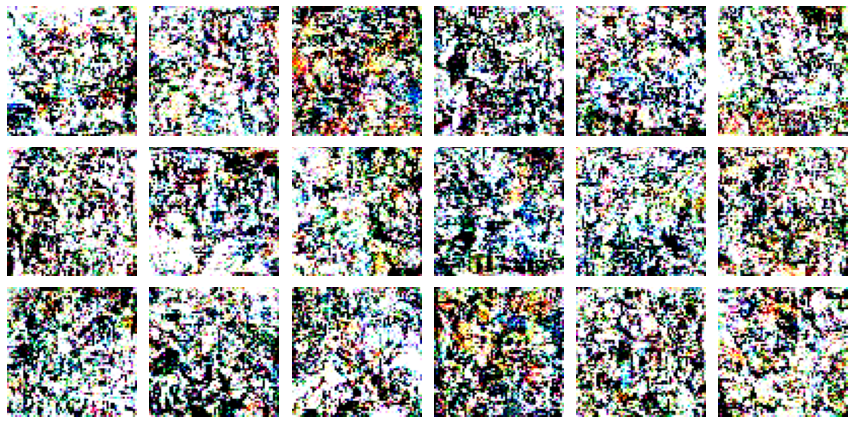

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1361 - i_loss: 0.2255
Epoch 5/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1342 - i_loss: 0.2213

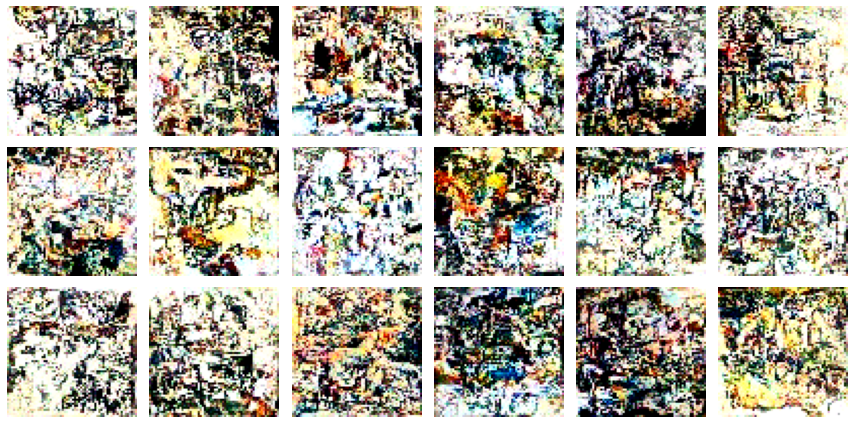

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1342 - i_loss: 0.2213
Epoch 6/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1322 - i_loss: 0.2183

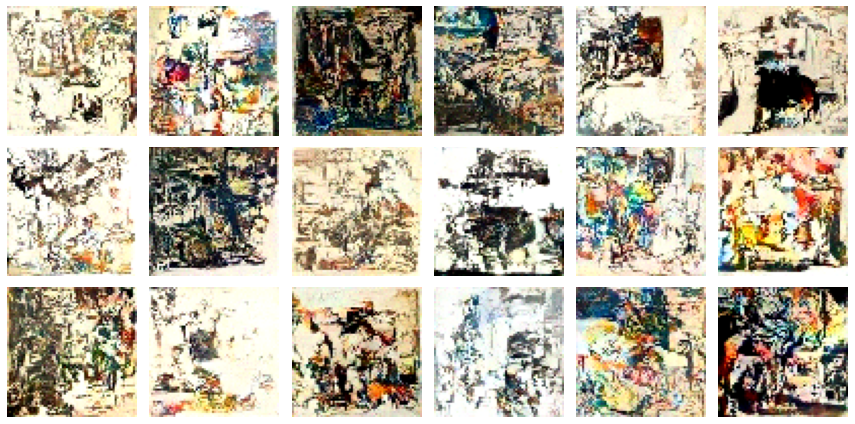

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1322 - i_loss: 0.2183
Epoch 7/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1324 - i_loss: 0.2154

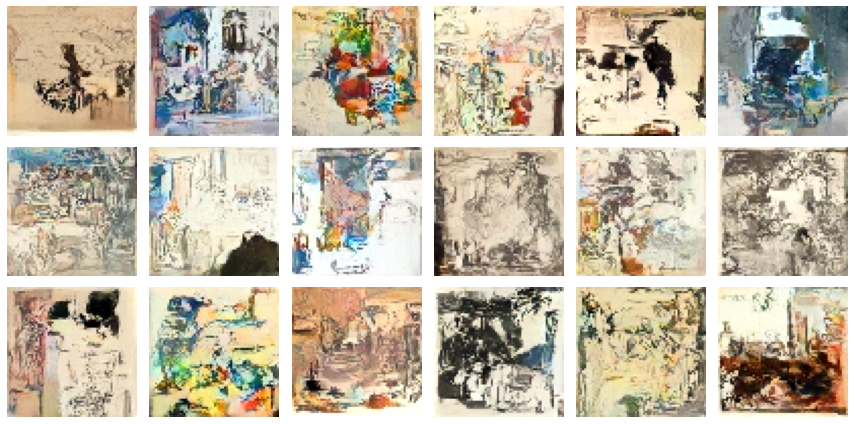

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1324 - i_loss: 0.2154
Epoch 8/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1316 - i_loss: 0.2130

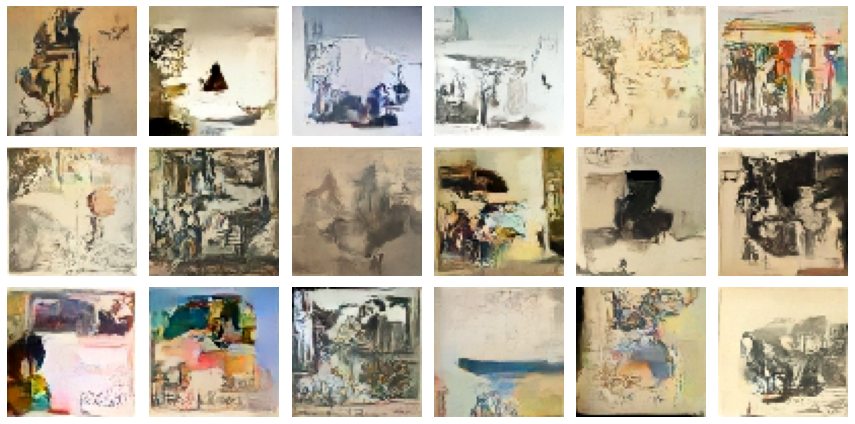

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1316 - i_loss: 0.2130
Epoch 9/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1306 - i_loss: 0.2147

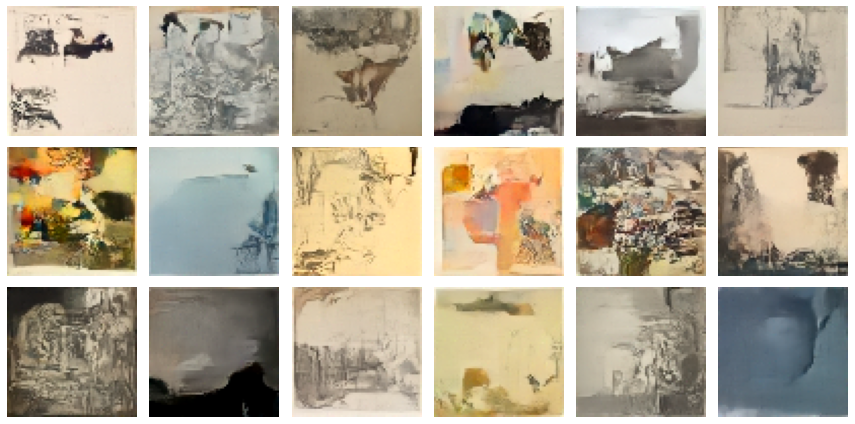

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1306 - i_loss: 0.2147
Epoch 10/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1302 - i_loss: 0.2117

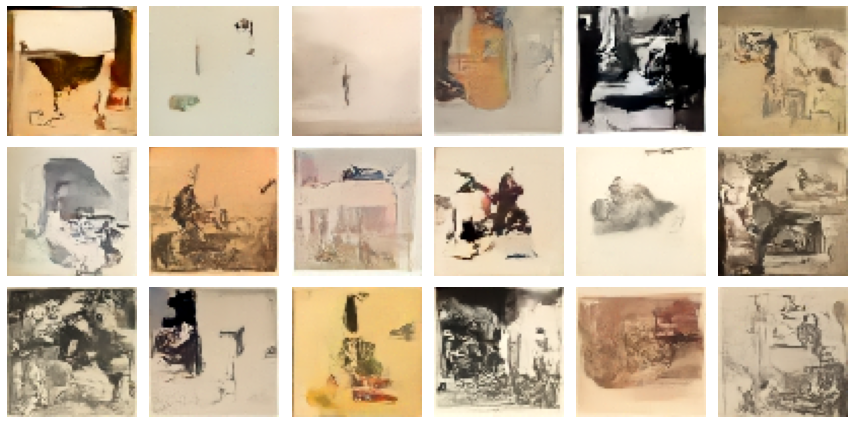

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1302 - i_loss: 0.2117
Epoch 11/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1297 - i_loss: 0.2114

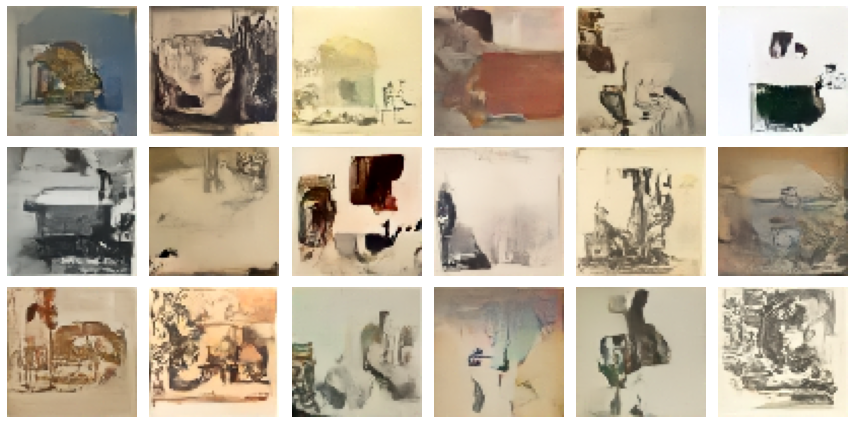

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1297 - i_loss: 0.2114
Epoch 12/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1296 - i_loss: 0.2094

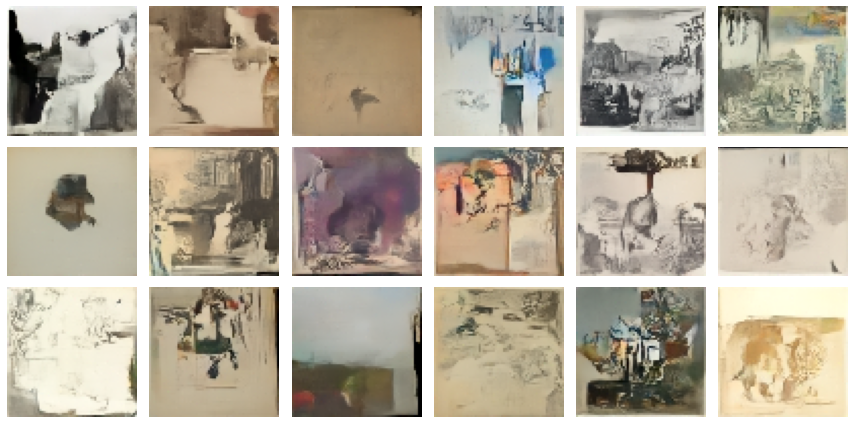

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1296 - i_loss: 0.2094
Epoch 13/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1290 - i_loss: 0.2101

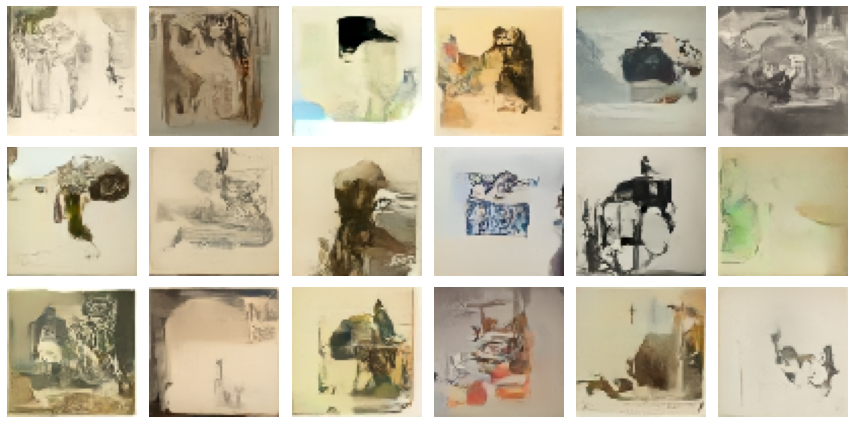

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1290 - i_loss: 0.2101
Epoch 14/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1293 - i_loss: 0.2089

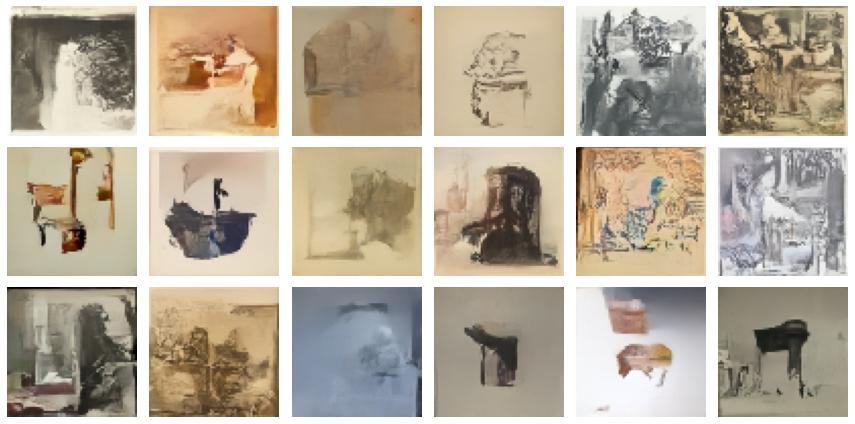

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1293 - i_loss: 0.2089
Epoch 15/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1291 - i_loss: 0.2079

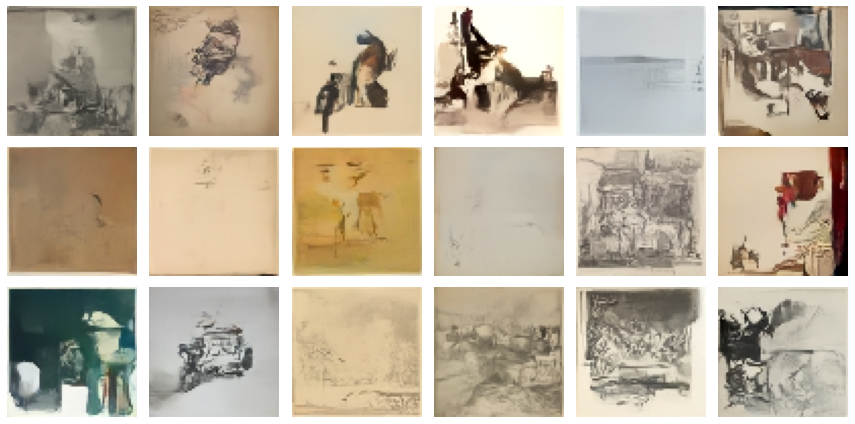

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1291 - i_loss: 0.2079
Epoch 16/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1284 - i_loss: 0.2085

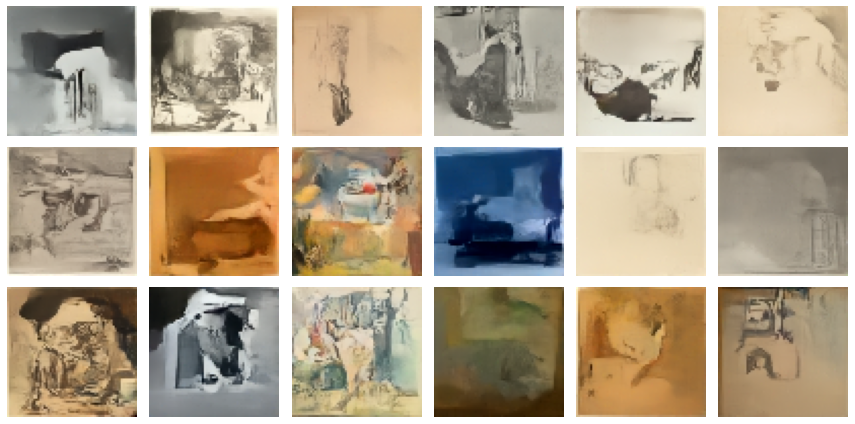

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1284 - i_loss: 0.2085
Epoch 17/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1283 - i_loss: 0.2083

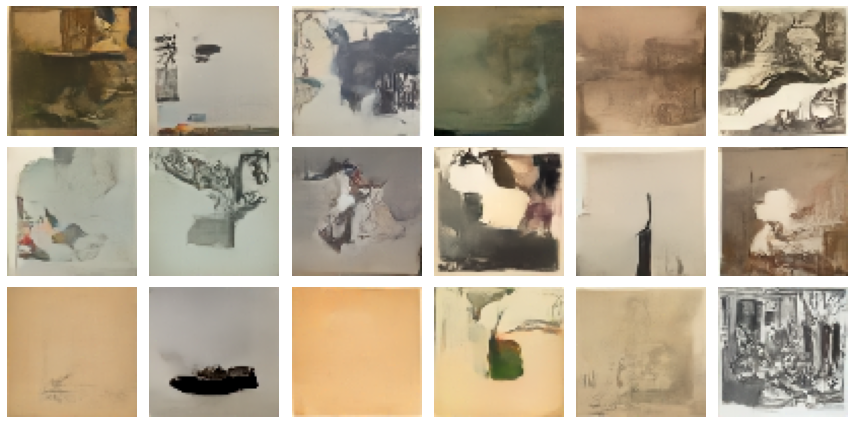

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1283 - i_loss: 0.2083
Epoch 18/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1283 - i_loss: 0.2084

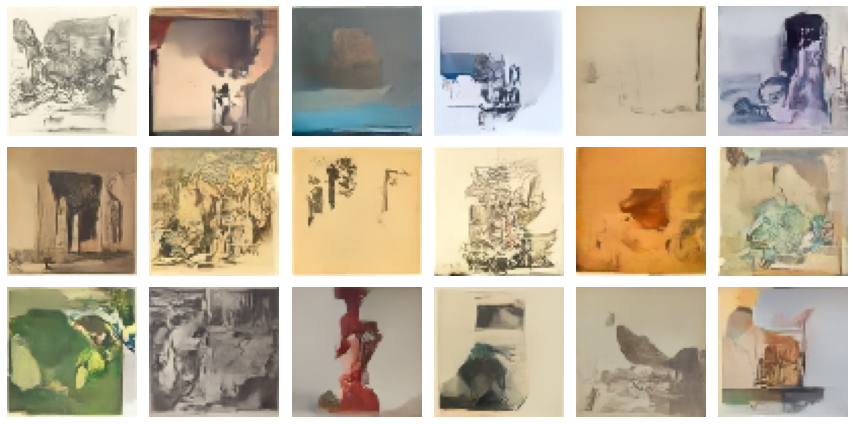

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1283 - i_loss: 0.2084
Epoch 19/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1282 - i_loss: 0.2068

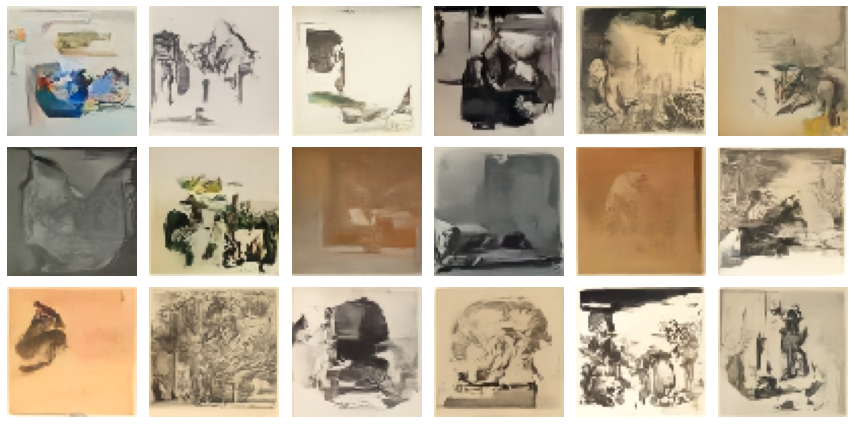

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1282 - i_loss: 0.2068
Epoch 20/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1279 - i_loss: 0.2075

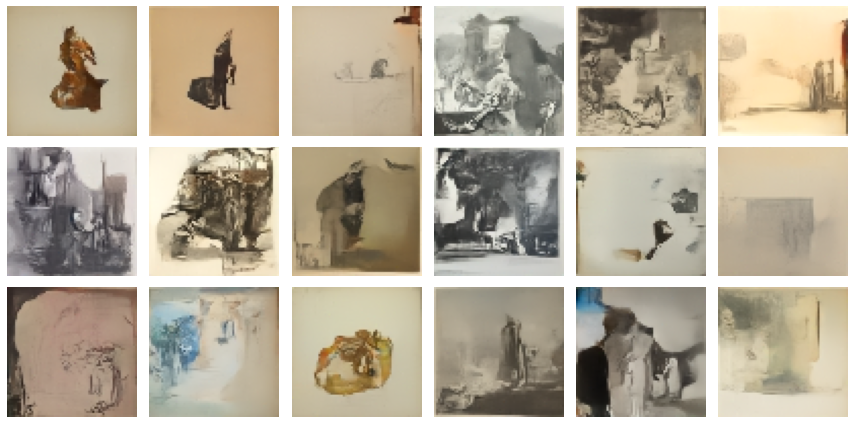

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1279 - i_loss: 0.2075
Epoch 21/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1276 - i_loss: 0.2074

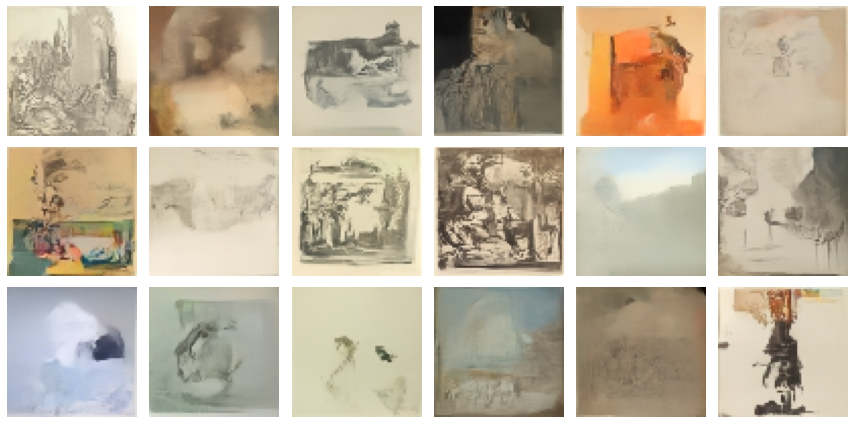

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1276 - i_loss: 0.2074
Epoch 22/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1277 - i_loss: 0.2065

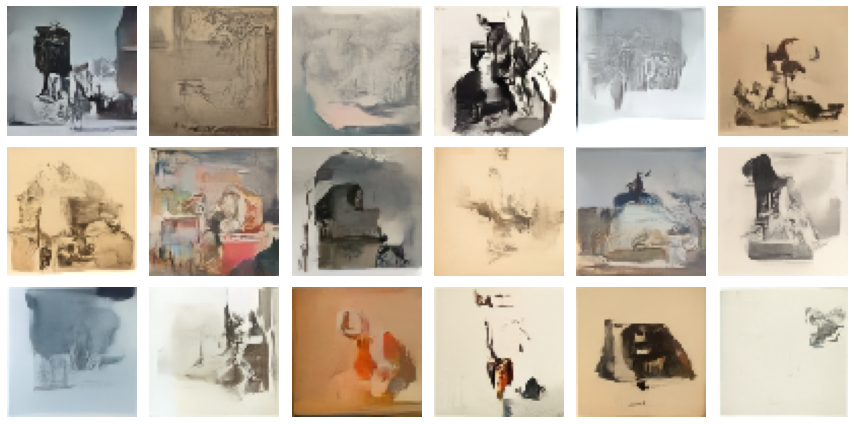

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1277 - i_loss: 0.2065
Epoch 23/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1279 - i_loss: 0.2063

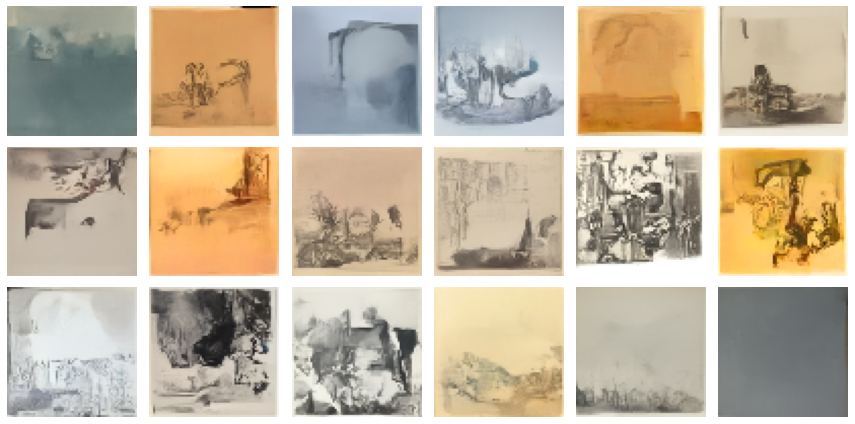

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1279 - i_loss: 0.2063
Epoch 24/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1274 - i_loss: 0.2062

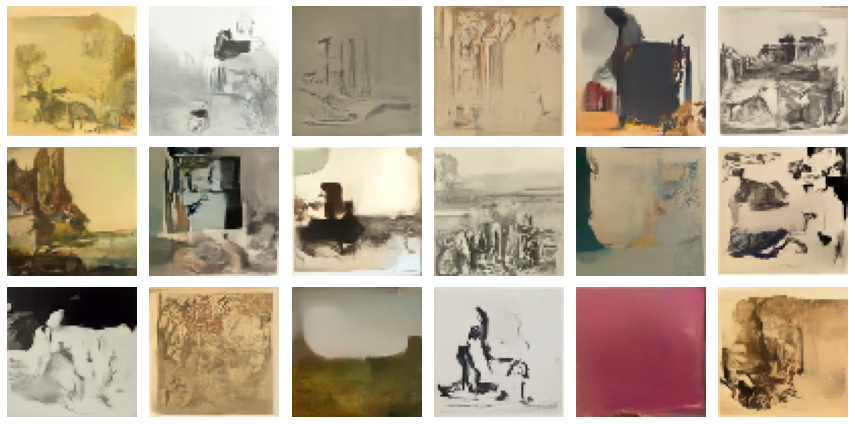

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1274 - i_loss: 0.2062
Epoch 25/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1274 - i_loss: 0.2056

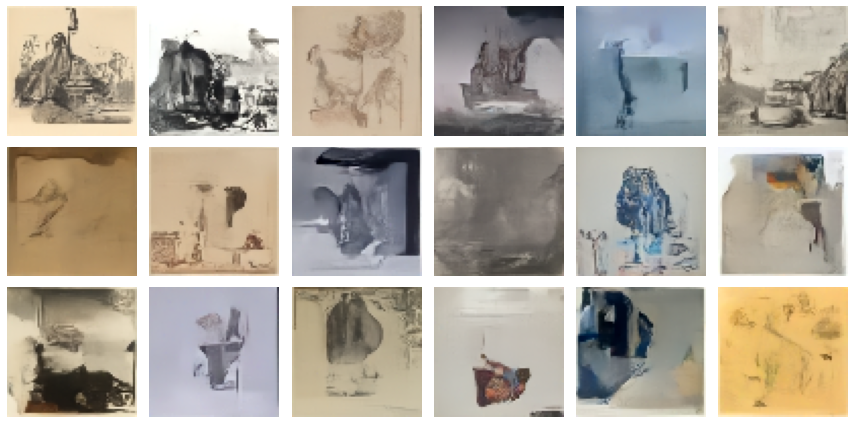

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1274 - i_loss: 0.2056
Epoch 26/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1271 - i_loss: 0.2073

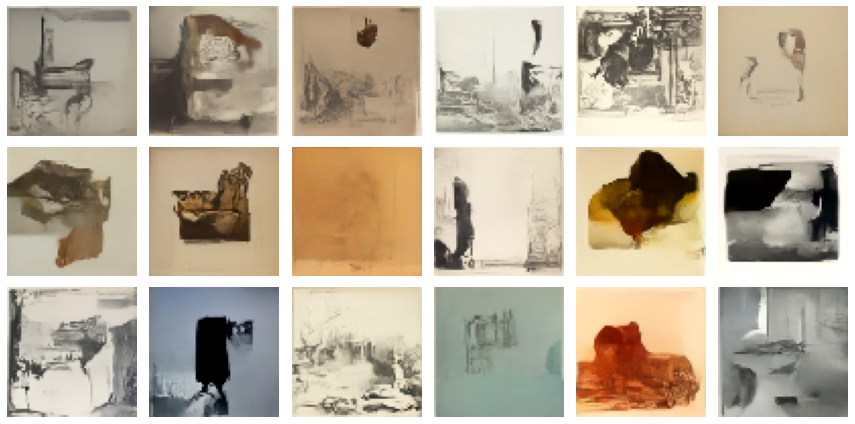

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1271 - i_loss: 0.2073
Epoch 27/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1270 - i_loss: 0.2071

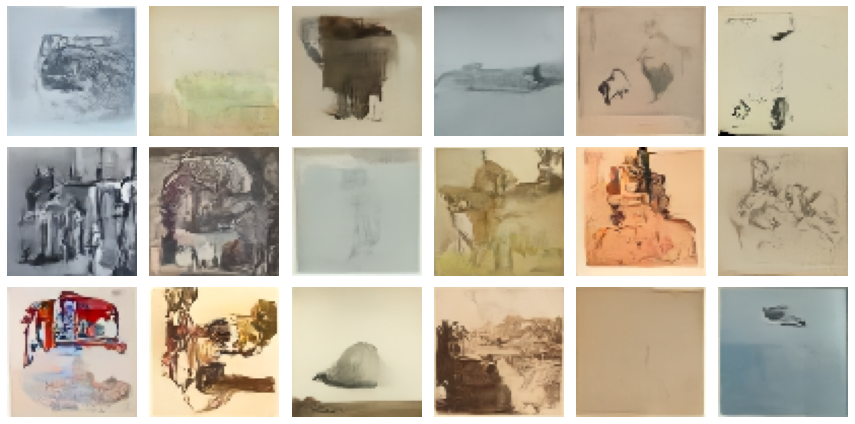

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1270 - i_loss: 0.2071
Epoch 28/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1268 - i_loss: 0.2059

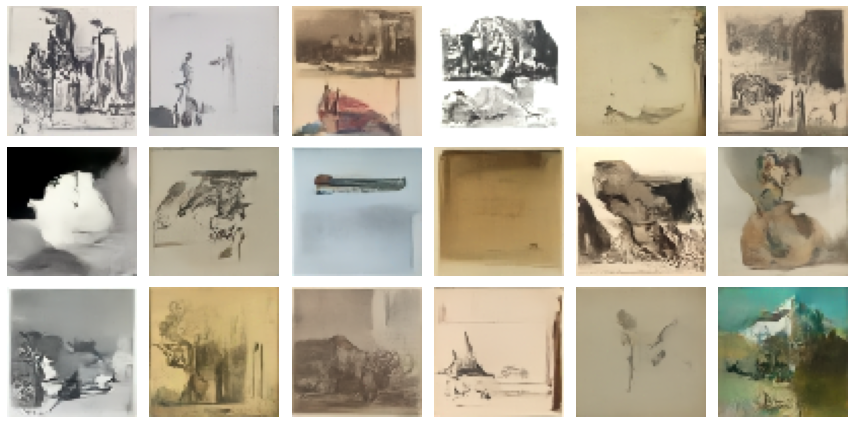

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1268 - i_loss: 0.2059
Epoch 29/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1266 - i_loss: 0.2060

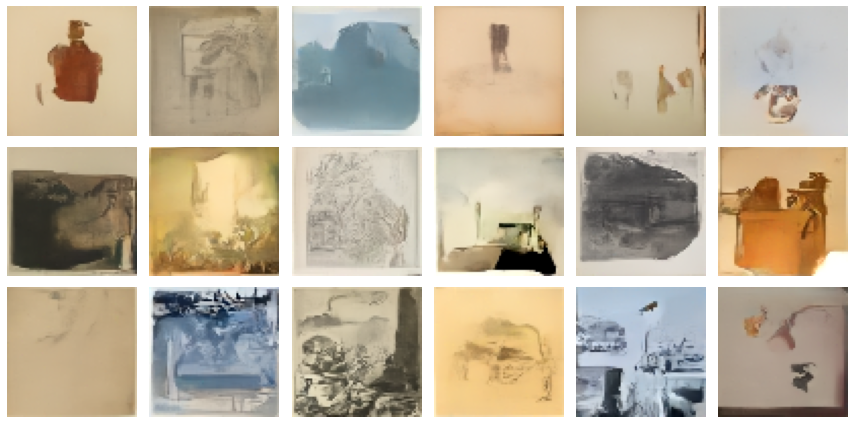

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1266 - i_loss: 0.2060
Epoch 30/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1270 - i_loss: 0.2044

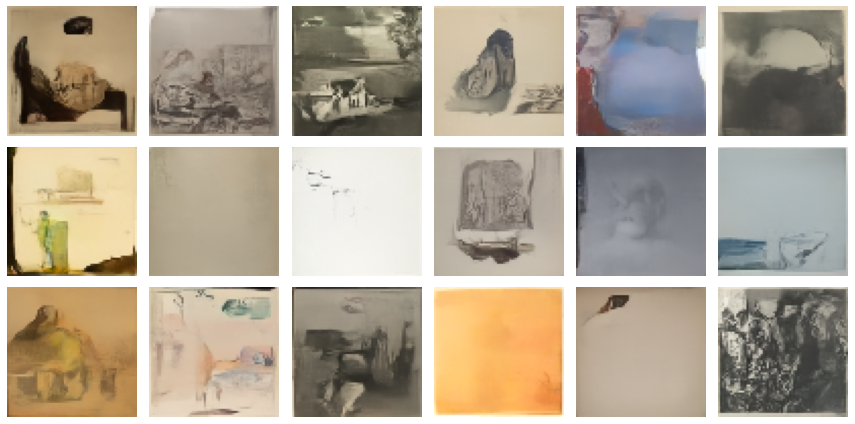

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1270 - i_loss: 0.2044
Epoch 31/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1275 - i_loss: 0.2065

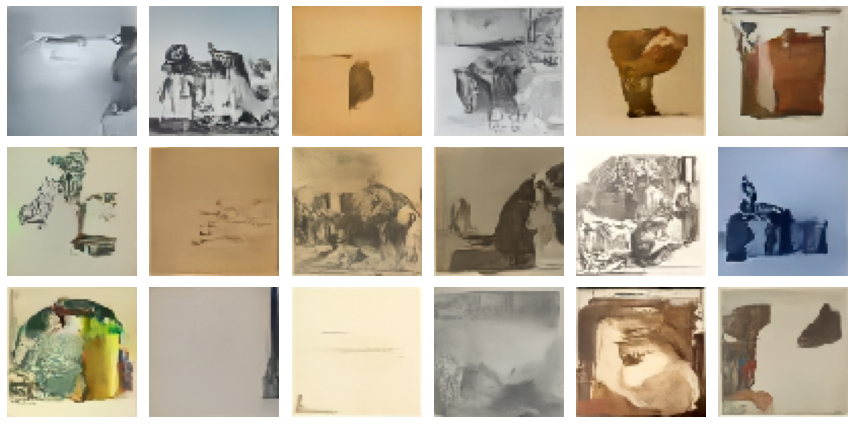

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1275 - i_loss: 0.2065
Epoch 32/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1272 - i_loss: 0.2048

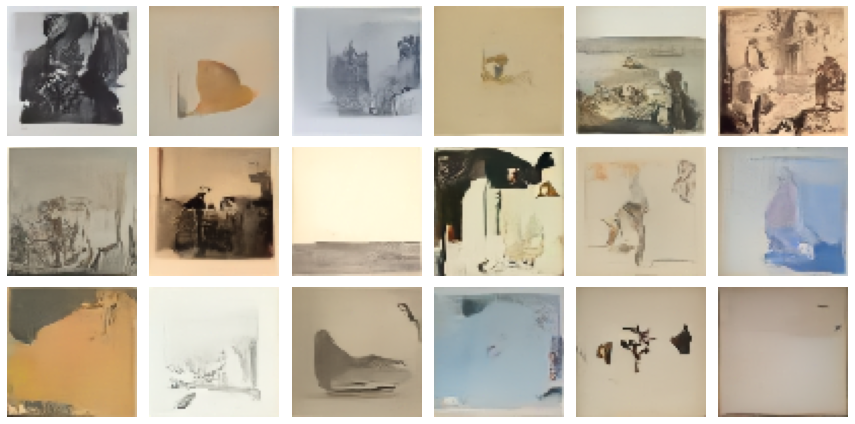

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1272 - i_loss: 0.2048
Epoch 33/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1270 - i_loss: 0.2048

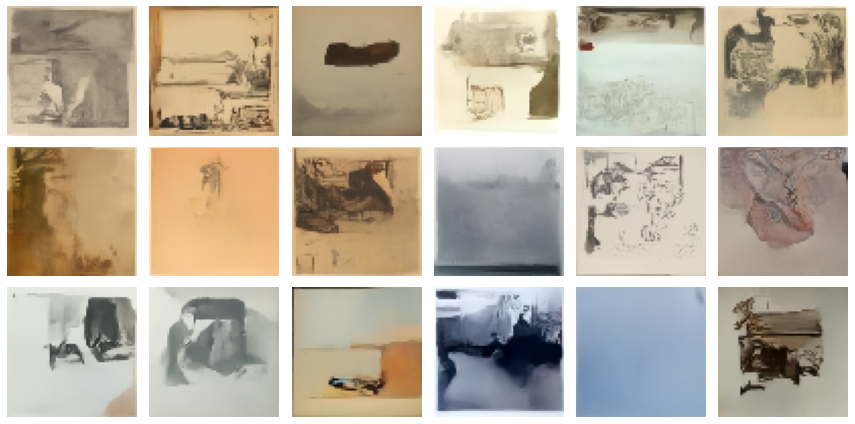

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1270 - i_loss: 0.2048
Epoch 34/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1267 - i_loss: 0.2040

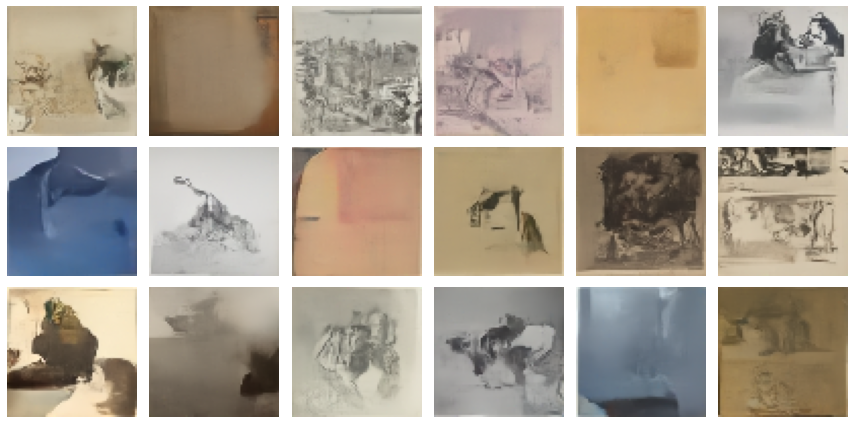

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1267 - i_loss: 0.2040
Epoch 35/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1270 - i_loss: 0.2053

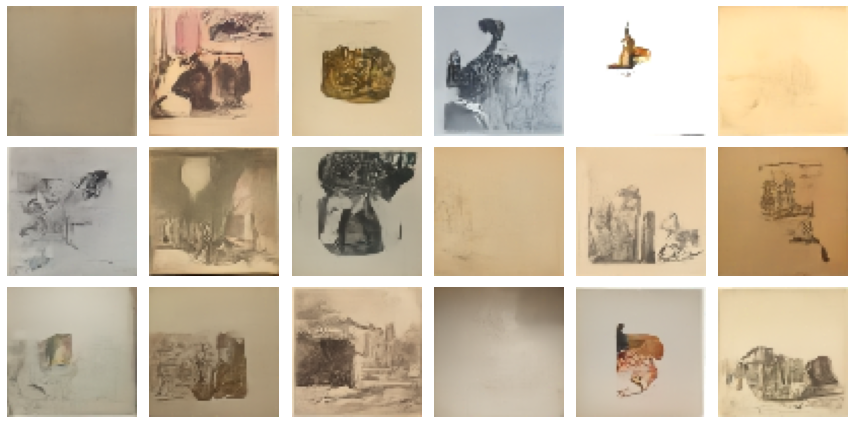

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1270 - i_loss: 0.2053
Epoch 36/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1269 - i_loss: 0.2052

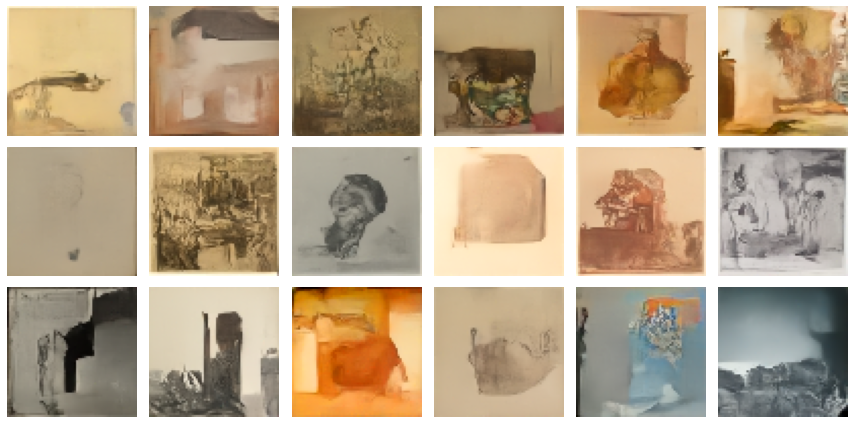

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1269 - i_loss: 0.2052
Epoch 37/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1262 - i_loss: 0.2054

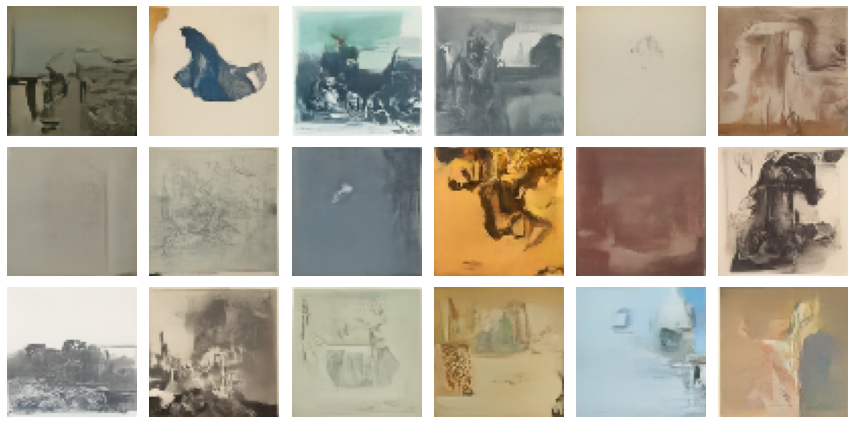

814/814 [==============================] - 52s 64ms/step - n_loss: 0.1262 - i_loss: 0.2054
Epoch 38/50
814/814 [==============================] - ETA: 0s - n_loss: 0.1273 - i_loss: 0.2057

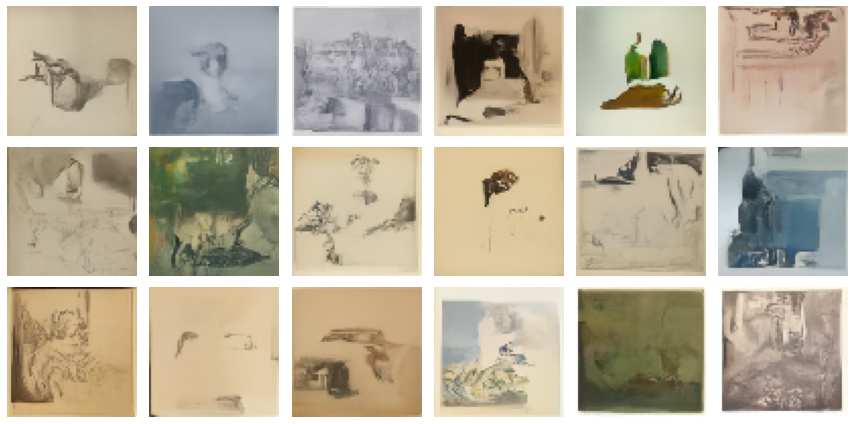

814/814 [==============================] - 53s 65ms/step - n_loss: 0.1273 - i_loss: 0.2057
Epoch 39/50
572/814 [====================>.........] - ETA: 14s - n_loss: 0.1264 - i_loss: 0.2047

In [ ]:
# create and compile the model
model = DiffusionModel(image_size, widths, block_depth)
# below tensorflow 2.9:
# pip install tensorflow_addons
# import tensorflow_addons as tfa
# optimizer=tfa.optimizers.AdamW
model.compile(
    optimizer=tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)
# pixelwise mean absolute error is used as loss

# save the best model based on the validation KID metric
checkpoint_path = "checkpoints/diffusion_model"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

# calculate mean and variance of training dataset for normalization
model.normalizer.adapt(train_dataset)

# run training and plot generated images periodically
model.fit(
    train_dataset,
    epochs=50,
    # validation_data=val_dataset,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

## Inference

In [ ]:
# load the best model and generate images
model.load_weights(checkpoint_path)
model.plot_images()